In [29]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

%matplotlib inline
import plotly.graph_objects as go

from sklearn.cluster import KMeans

In [30]:
# Read in a photo
img = plt.imread('using_kmeans_for_color_compression_tulips_photo.jpg')

(320, 240, 3)


(-0.5, 239.5, 319.5, -0.5)

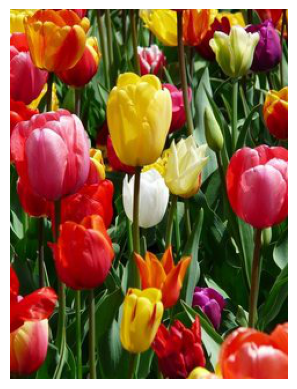

In [31]:
# Display the photo and its shape
print(img.shape)
plt.imshow(img)
plt.axis('off')

In [32]:
# Reshape the image so that each row represents a single pixel 
# defined by three values: R, G, B
img_flat = img.reshape(img.shape[0]*img.shape[1], 3)
img_flat[:5, :]

array([[211, 196,  41],
       [199, 180,  24],
       [179, 152,   0],
       [186, 150,   0],
       [187, 143,   0]], dtype=uint8)

In [33]:
img_flat.shape

(76800, 3)

In [34]:
# Create a pandas df with r, g, and b as columns
img_flat_df = pd.DataFrame(img_flat, columns=['r', 'g', 'b'])
img_flat_df.head()

,r,g,b
0,211,196,41
1,199,180,24
2,179,152,0
3,186,150,0
4,187,143,0


In [35]:
# Create 3D plot where each pixel in the 'img' is displayed in its actual color
trace = go.Scatter3d(x = img_flat_df.r,
                     y = img_flat_df.g,
                     z = img_flat_df.b,
                     mode = 'markers',
                     marker = dict(size = 1,
                                   color = ['rgb({},{},{})'.format(r,g,b) for r,g,b
                                            in zip(img_flat_df.r.values,
                                                   img_flat_df.g.values,
                                                   img_flat_df.b.values)],
                                                   opacity=0.5))
data = [trace]

layout = go.Layout(margin =  dict(l=0,
                                  r=0,
                                  b=0,
                                  t=0),
                                  )

fig = go.Figure(data = data, layout = layout)
fig.update_layout(scene = dict(
                    xaxis_title = 'R',
                    yaxis_title = 'G',
                    zaxis_title = 'B'),
                )

fig.show()

Cluster the data: k = 1

In [36]:
# Instantiate the model
kmeans = KMeans(n_clusters=1, random_state=42).fit(img_flat)

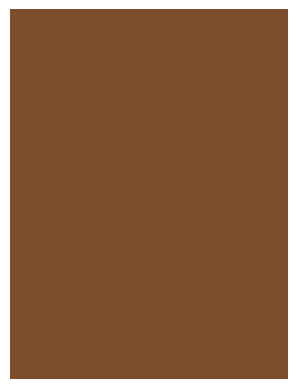

In [37]:
# Copy `img_flat` so we can modify it
img_flat1 = img_flat.copy()

# Replace each row in the original image with its closest cluster center
for i in np.unique(kmeans.labels_):
    img_flat1[kmeans.labels_==i,:] = kmeans.cluster_centers_[i]

# Reshape the data back to (640, 480, 3)
img1 = img_flat1.reshape(img.shape)

plt.imshow(img1)
plt.axis('off');

In [38]:
# Calculate mean of each column in the flattened array
column_means = img_flat.mean(axis = 0)
print('column_means: ', column_means)

column_means:  [125.64397135  78.93165365  43.51584635]


In [39]:
print('cluster center: ', kmeans.cluster_centers_)


cluster center:  [[125.64397135  78.93165365  43.51584635]]


In [40]:
# Create 3-D plot where each pixel in the `img` is displayed in its actual color
trace = go.Scatter3d(x = img_flat_df.r,
                     y = img_flat_df.g,
                     z = img_flat_df.b,
                     mode='markers',
                     marker=dict(size=1,
                                 color=['rgb({},{},{})'.format(r,g,b) for 
                                        r,g,b in zip(img_flat_df.r.values, 
                                                     img_flat_df.g.values, 
                                                     img_flat_df.b.values)],
                                 opacity=0.5))

data = [trace]

layout = go.Layout(margin=dict(l=0,
                               r=0,
                               b=0,
                               t=0))

fig = go.Figure(data=data, layout=layout)


# Add centroid to chart
centroid = kmeans.cluster_centers_[0].tolist()

fig.add_trace(
    go.Scatter3d(x = [centroid[0]],
                 y = [centroid[1]],
                 z = [centroid[2]],
                 mode='markers',
                 marker=dict(size=7,
                             color=['rgb(125.79706706,78.8178776,42.58090169)'],
                             opacity=1))
)
fig.update_layout(scene = dict(
                    xaxis_title='R',
                    yaxis_title='G',
                    zaxis_title='B'),
                  )
fig.show()

Cluster the data: k=3

In [41]:
# Instantiate k-means model for 3 clusters
kmeans3 = KMeans(n_clusters=3, random_state=42).fit(img_flat)

# Check the unique values of what's returned by the .labels_ attribute 
np.unique(kmeans3.labels_)

array([0, 1, 2], dtype=int32)

In [42]:
# Assign centroid coordinates to `centers` variable
centers = kmeans3.cluster_centers_
centers

array([[202.39763431, 174.37038195, 110.68386223],
       [ 40.83604502,  50.50578017,  16.27870206],
       [177.83256393,  42.71891935,  27.52205853]])

In [43]:
# Helper function that creates color swatches
def show_swatch(RGB_value):
    '''
    Takes in an RGB value and outputs a color swatch
    '''
    R, G, B = RGB_value
    rgb = [[np.array([R,G,B]).astype('uint8')]]
    plt.figure()
    plt.imshow(rgb)
    plt.axis('off');

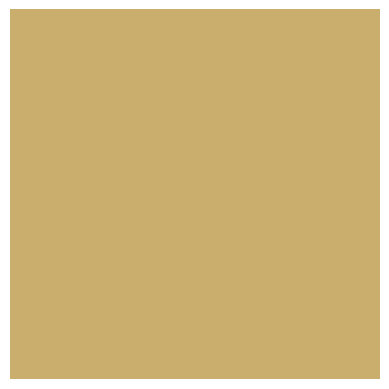

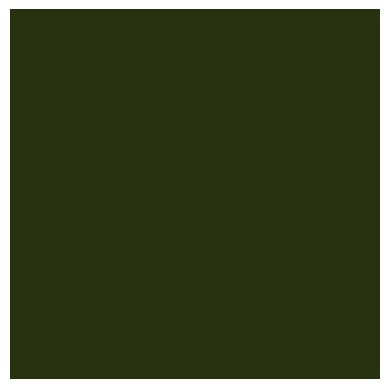

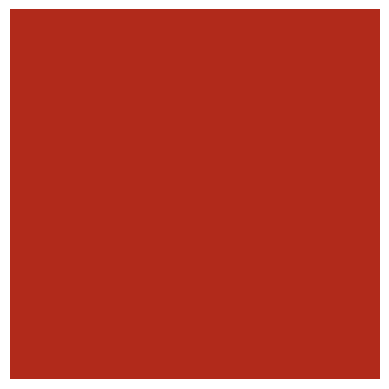

In [44]:
# Display the color swatches
for pixel in centers:
    show_swatch(pixel)

In [45]:
# Helper function to display our photograph when clustered into k clusters
def cluster_image(k, img=img):
    '''
    Fits a K-means model to a photograph.
    Replaces photo's pixels with RGB values of model's centroids.
    Displays the updated image.

    Args:
      k:    (int)          - Your selected K-value
      img:  (numpy array)  - Your original image converted to a numpy array

    Returns:
      The output of plt.imshow(new_img), where new_img is a new numpy array \
      where each row of the original array has been replaced with the \ 
      coordinates of its nearest centroid.
    '''

    img_flat = img.reshape(img.shape[0]*img.shape[1], 3)
    kmeans = KMeans(n_clusters = k, random_state = 42).fit(img_flat)
    new_img = img_flat.copy()
  
    for i in np.unique(kmeans.labels_):
        new_img[kmeans.labels_ == i, :] = kmeans.cluster_centers_[i]
  
    new_img = new_img.reshape(img.shape)

    return plt.imshow(new_img), plt.axis('off');
  

<>:3: SyntaxWarning:

invalid escape sequence '\ '

<>:3: SyntaxWarning:

invalid escape sequence '\ '

/var/folders/65/8_9mpm955ys3m2cj2f2k6mmw0000gn/T/ipykernel_60710/3127752140.py:3: SyntaxWarning:

invalid escape sequence '\ '



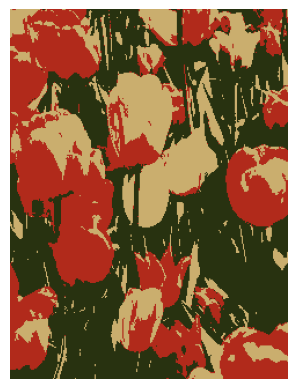

In [46]:
cluster_image(3);

In [47]:
# Just to get an understanding of what the data structures look like

print(kmeans3.labels_.shape)
print(kmeans3.labels_)
print(np.unique(kmeans3.labels_))
print(kmeans3.cluster_centers_)

(76800,)
[0 0 2 ... 2 2 2]
[0 1 2]
[[202.39763431 174.37038195 110.68386223]
 [ 40.83604502  50.50578017  16.27870206]
 [177.83256393  42.71891935  27.52205853]]


In [48]:
# Create a new column in the df that indicates the cluster number of each row 
# (as assigned by Kmeans for k=3)
img_flat_df['cluster'] = kmeans3.labels_
img_flat_df.head()

,r,g,b,cluster
0,211,196,41,0
1,199,180,24,0
2,179,152,0,2
3,186,150,0,2
4,187,143,0,2


In [49]:
# Create helper dictionary to map RGB color values to each observation in df
series_conversion = {0: 'rgb' +str(tuple(kmeans3.cluster_centers_[0])),
                     1: 'rgb' +str(tuple(kmeans3.cluster_centers_[1])),
                     2: 'rgb' +str(tuple(kmeans3.cluster_centers_[2])),
                     }
series_conversion

{0: 'rgb(202.39763430774536, 174.3703819498773, 110.68386222708364)',
 1: 'rgb(40.836045018039115, 50.505780170040836, 16.278702061286065)',
 2: 'rgb(177.83256392758102, 42.71891935289637, 27.522058528360493)'}

In [50]:
# Replace the cluster numbers in the 'cluster' col with formatted RGB values 
# (made ready for plotting)
img_flat_df['cluster'] = img_flat_df['cluster'].map(series_conversion)
img_flat_df.head()

,r,g,b,cluster
0,211,196,41,"rgb(202.39763430774536, 174.3703819498773, 110..."
1,199,180,24,"rgb(202.39763430774536, 174.3703819498773, 110..."
2,179,152,0,"rgb(177.83256392758102, 42.71891935289637, 27...."
3,186,150,0,"rgb(177.83256392758102, 42.71891935289637, 27...."
4,187,143,0,"rgb(177.83256392758102, 42.71891935289637, 27...."


In [51]:
# Replot the data, now showing which cluster (i.e., color) it was assigned to by K-means when k=3

trace = go.Scatter3d(x = img_flat_df.r,
                     y = img_flat_df.g,
                     z = img_flat_df.b,
                     mode='markers',
                     marker=dict(size=1,
                                 color=img_flat_df.cluster,
                                 opacity=1))

data = trace

layout = go.Layout(margin=dict(l=0,
                               r=0,
                               b=0,
                               t=0))

fig = go.Figure(data=data, layout=layout)
fig.show()

<>:3: SyntaxWarning:

invalid escape sequence '\ '

<>:3: SyntaxWarning:

invalid escape sequence '\ '

/var/folders/65/8_9mpm955ys3m2cj2f2k6mmw0000gn/T/ipykernel_60710/2856764794.py:3: SyntaxWarning:

invalid escape sequence '\ '



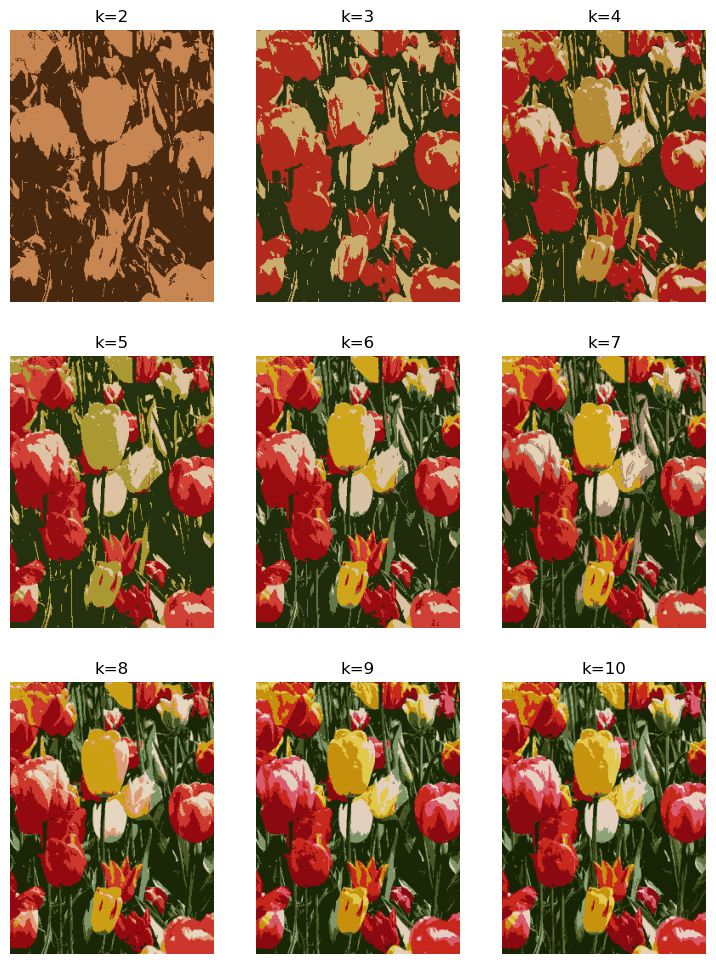

In [52]:
# Helper function to plot image grid
def cluster_image_grid(k, ax, img=img):
    '''
    Fits a K-means model to a photograph.
    Replaces photo's pixels with RGB values of model's centroids.
    Displays the updated image on an axis of a figure.

    Args:
      k:    (int)          - Your selected K-value
      ax:   (int)          - Index of the axis of the figure to plot to
      img:  (numpy array)  - Your original image converted to a numpy array

    Returns:
      A new image where each row of img's array has been replaced with the \ 
      coordinates of its nearest centroid. Image is assigned to an axis that \
      can be used in an image grid figure.
    '''
    img_flat = img.reshape(img.shape[0]*img.shape[1], 3)
    kmeans = KMeans(n_clusters=k, random_state=42).fit(img_flat)
    new_img = img_flat.copy()

    for i in np.unique(kmeans.labels_):
        new_img[kmeans.labels_==i, :] = kmeans.cluster_centers_[i]

    new_img = new_img.reshape(img.shape)
    ax.imshow(new_img)
    ax.axis('off')

fig, axs = plt.subplots(3, 3)
fig = matplotlib.pyplot.gcf()
fig.set_size_inches(9, 12)
axs = axs.flatten()
k_values = np.arange(2, 11)
for i, k in enumerate(k_values):
    cluster_image_grid(k, axs[i], img=img)
    axs[i].title.set_text('k=' + str(k))